Dataset: Abalone
Obtained from: UCI Repository

#### Parameters
- Feature 1: Length (mm)
- Feature 2: Diameter (mm)
- Feature 3: Height (mm)
- Feature 4: Whole weight (grams)
- Feature 5: Shucked weight (grams)
- Feature 6: Viscera weight (grams)
- Feature 7: Shell weight (grams)
- Target: Rings (number of rings)

# Regression Model

In [1]:
# Importing pandas library and aliasing it as pd
import pandas as pd

# Importing numpy library and aliasing it as np
import numpy as np

# Importing seaborn library and aliasing it as sns
import seaborn as sns

# Importing matplotlib.pyplot module from matplotlib library and aliasing it as plt
import matplotlib.pyplot as plt

# Importing stats module from scipy library and aliasing it as stats
import scipy.stats as stats

# Import the statsmodels library
import statsmodels.api as sm

# Importing fetch_ucirepo function from ucimlrepo module
from ucimlrepo import fetch_ucirepo 

# Importing required regression models from scikit-learn library
from sklearn.linear_model import  Ridge

# Importing train_test_split function from model_selection module in scikit-learn
from sklearn.model_selection import train_test_split

# Importing metrics module from scikit-learn
from sklearn import metrics

# Importing OneHotEncoder class and StandardScaler class from preprocessing module in scikit-learn
from sklearn.preprocessing import   StandardScaler 

# Importing Pipeline class from pipeline module in scikit-learn
from sklearn.pipeline import Pipeline 

# Importing ColumnTransformer class from compose module in scikit-learn
from sklearn.compose import ColumnTransformer

# Importing CatBoost and CatBoostRegressor classes from catboost library
from catboost import CatBoost , CatBoostRegressor

# Import GridSearchCV from scikit-learn
from sklearn.model_selection import GridSearchCV

# Set the seaborn theme to 'darkgrid'
sns.set_theme(style='darkgrid')

# Set the context of the seaborn plots to 'paper'
sns.set_context("paper")

In [2]:
# fetch dataset from UCI database
heart_attack = fetch_ucirepo(id=1)

#Read the original dataset into a pandas dataframe
df = heart_attack.data.original

In [3]:
#View general informaiton of the dataset
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4177 entries, 0 to 4176
Data columns (total 9 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Sex             4177 non-null   object 
 1   Length          4177 non-null   float64
 2   Diameter        4177 non-null   float64
 3   Height          4177 non-null   float64
 4   Whole_weight    4177 non-null   float64
 5   Shucked_weight  4177 non-null   float64
 6   Viscera_weight  4177 non-null   float64
 7   Shell_weight    4177 non-null   float64
 8   Rings           4177 non-null   int64  
dtypes: float64(7), int64(1), object(1)
memory usage: 293.8+ KB


In [4]:
#View the first 5 rows of the dataset
df.head()

,Sex,Length,Diameter,Height,Whole_weight,Shucked_weight,Viscera_weight,Shell_weight,Rings
0,M,0.455,0.365,0.095,0.5140,0.2245,0.1010,0.150,15
1,M,0.350,0.265,0.090,0.2255,0.0995,0.0485,0.070,7
2,F,0.530,0.420,0.135,0.6770,0.2565,0.1415,0.210,9
3,M,0.440,0.365,0.125,0.5160,0.2155,0.1140,0.155,10
4,I,0.330,0.255,0.080,0.2050,0.0895,0.0395,0.055,7


In [5]:
#Checking if there are any null values with iunt dataset
df.isnull().sum()

Sex               0
Length            0
Diameter          0
Height            0
Whole_weight      0
Shucked_weight    0
Viscera_weight    0
Shell_weight      0
Rings             0
dtype: int64

In [6]:
# Calculate the total weight by summing the Shell_weight, Shucked_weight, and Viscera_weight columns
df['Total_weight'] = df['Shell_weight'] + df['Shucked_weight'] + df['Viscera_weight']

In [7]:
# Calculate the missing weight by subtracting the Total_weight from the Whole_weight
df['missing_weight'] = (df['Whole_weight'] - df['Total_weight'])

# Drop the Total_weight column as it was used only for intermediate calculations
df.drop(['Total_weight'], axis=1, inplace=True)

In [8]:
df.head()

,Sex,Length,Diameter,Height,Whole_weight,Shucked_weight,Viscera_weight,Shell_weight,Rings,missing_weight
0,M,0.455,0.365,0.095,0.5140,0.2245,0.1010,0.150,15,0.0385
1,M,0.350,0.265,0.090,0.2255,0.0995,0.0485,0.070,7,0.0075
2,F,0.530,0.420,0.135,0.6770,0.2565,0.1415,0.210,9,0.0690
3,M,0.440,0.365,0.125,0.5160,0.2155,0.1140,0.155,10,0.0315
4,I,0.330,0.255,0.080,0.2050,0.0895,0.0395,0.055,7,0.0210


## Data Quality

In [9]:
# Select numerical columns from the DataFrame
num_cols = df.select_dtypes('number').columns

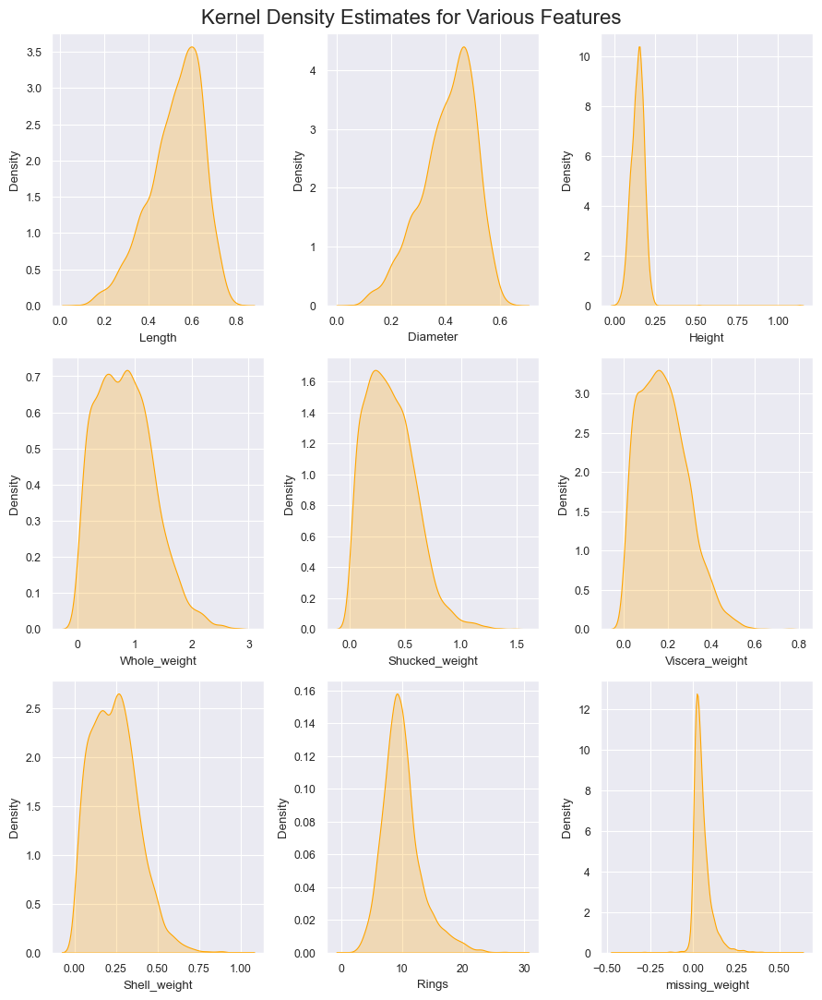

In [10]:
# Create subplots with 3 rows and 3 columns, and set the overall figure size
fig, ax = plt.subplots(nrows=3, ncols=3, figsize=(9, 11))

# Set the title for the entire figure
plt.suptitle('Kernel Density Estimates for Various Features', fontsize=16)

# Iterate over numerical columns and plot kernel density estimates for each column
for i, col in enumerate(num_cols, 0):
    # Set the subplot position
    plt.subplot(3, 3, i+1)
    
    # Plot the kernel density estimate for the current column
    sns.kdeplot(df[col], color='orange', fill=True)

# Adjust the layout of subplots to prevent overlapping
plt.tight_layout()

# Display the plot
plt.show()

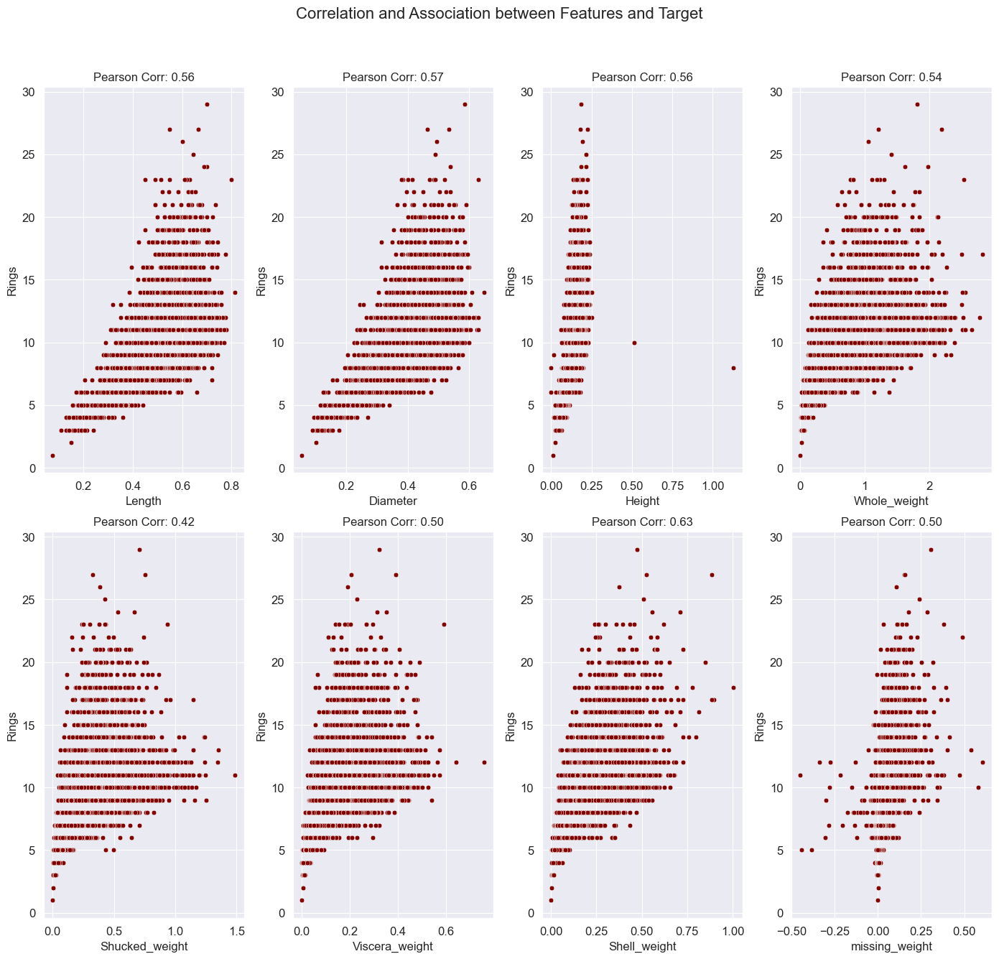

In [11]:
from scipy.stats import pearsonr

# Create subplots with 2 rows and 4 columns, and set the overall figure size
fig, ax = plt.subplots(nrows=2, ncols=4, figsize=(14, 14))

# Set the title for the entire figure
plt.suptitle('Correlation and Association between Features and Target', fontsize=16)

# Iterate over numerical columns except 'Rings' and plot regression plots with correlation coefficients
for i, col in enumerate(num_cols.drop('Rings'), 0):
    # Set the subplot position
    plt.subplot(2, 4, i + 1)
    
    # Plot the regression plot between 'Rings' and the current column
    sns.scatterplot(y=df['Rings'], x=df[col],
                color='maroon')
               # scatter_kws={'s': 6},
                #ci=False, 
                #order=False)

    # Calculate Pearson correlation coefficient
    corr_coef, _ = pearsonr(df[col], df['Rings'])
    
    # Set x-label, y-label, and title with Pearson correlation coefficient
    plt.xlabel(col, fontsize=12)
    plt.ylabel('Rings', fontsize=12)
    plt.title(f'Pearson Corr: {corr_coef:.2f}', fontsize=12)
    
    # Set font size for x-axis and y-axis ticks
    plt.tick_params(axis='x', which='both', labelsize=12)
    plt.tick_params(axis='y', which='both', labelsize=12)

# Adjust the layout of subplots to prevent overlapping
plt.tight_layout(rect=[0, 0.03, 1, 0.95])

# Display the plot
plt.show()


## Insert a method or whatever that shows heights were found to be 0

In [12]:
df['Height'].replace(0 , df['Height'].median(),inplace= True)

C:\Users\ameerul\AppData\Local\Temp\ipykernel_27944\1967281437.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['Height'].replace(0 , df['Height'].median(),inplace= True)


<Axes: >

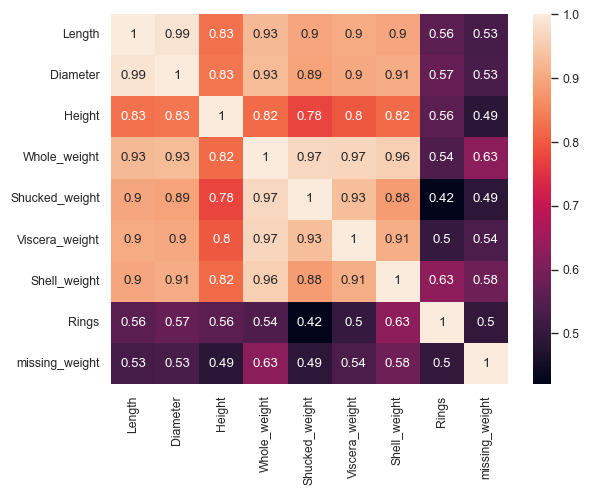

In [13]:
sns.heatmap(df[num_cols].corr() , annot= True )

In [14]:
# Create new binary columns for each category in the 'Sex' column
# Convert 'Sex' column to binary indicators: 1 for the respective category, 0 otherwise
df['Sex_M'] = (df['Sex'] == "M").astype(int)  # 1 if male, 0 otherwise
df['Sex_F'] = (df['Sex'] == "F").astype(int)  # 1 if female, 0 otherwise
df['Sex_I'] = (df['Sex'] == "I").astype(int)  # 1 if infant, 0 otherwise

# Drop the original 'Sex' column as it is now represented by the binary indicator columns
df.drop('Sex', axis=1, inplace=True)

In [15]:
# Remove the target variable 'Rings' from the list of numerical columns
num_cols = num_cols.drop('Rings')

In [16]:
# Add a constant term to the features matrix for Ordinary Least Squares (OLS) regression
X_ols = sm.add_constant(df.drop(['Rings'], axis=1))
y_ols = df['Rings']  # Define the target variable

# Fit an Ordinary Least Squares (OLS) linear model
model_ols = sm.OLS(y_ols, X_ols).fit()

# Display the summary of the OLS linear model
print("OLS Linear Model Summary:")
print(model_ols.summary())

# Extract p-values for each feature in the OLS linear model
p_values_ols = model_ols.pvalues
print("\nP-values for each feature in OLS Linear Model:")
print(p_values_ols)

OLS Linear Model Summary:
                            OLS Regression Results                            
Dep. Variable:                  Rings   R-squared:                       0.537
Model:                            OLS   Adj. R-squared:                  0.536
Method:                 Least Squares   F-statistic:                     536.4
Date:                Wed, 13 Mar 2024   Prob (F-statistic):               0.00
Time:                        11:03:58   Log-Likelihood:                -9209.3
No. Observations:                4177   AIC:                         1.844e+04
Df Residuals:                    4167   BIC:                         1.850e+04
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                     coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------
const          -1.

In [17]:
def GetPipeline(algo , num_cols ):
    
    #Defining a pipeline for the numrical columns
    numeric_transformer = Pipeline(steps=[
        #Scales the data to zero mean and unit variance
       ('scaler', StandardScaler())])
    #Defining a pipeline for the numrical columns

    # Combine the numeric and categorical transformers using a ColumnTransformer
    preprocessor = ColumnTransformer(
        transformers=[
            # Apply the numeric pipeline to numeric columns
            ('num', numeric_transformer, num_cols)
         ]
            )


    model = Pipeline(steps=[
        # Preprocess the data using the combined transformer
        ('preprocessor', preprocessor),
        
        # Apply the specified Regression algorithm
        ('regression', algo) 
    ])

    
    return model 

## Creating Baseline Model

In [18]:
# Splitting the data into features and target variable
features = df.drop(['Rings', 'Length'], axis=1)  # Features without 'Rings' and 'Length' columns
target = df['Rings']  # Target variable 'Rings'

In [19]:
# Splitting the data into training and testing sets
x_train, x_test, y_train, y_test = train_test_split(features, target, train_size=0.7, random_state=42)


In [20]:
# Define a function to print evaluation metrics
def print_evaluate(true, predicted, x_train): 
    # Calculate evaluation metrics
    mae = metrics.mean_absolute_error(true, predicted)
    mse = metrics.mean_squared_error(true, predicted)
    rmse = np.sqrt(metrics.mean_squared_error(true, predicted))
    r2_square = metrics.r2_score(true, predicted)
    
    # Calculate adjusted R-squared
    n = len(x_train)
    p = x_train.shape[1]
    r2_adjusted = 1 - ((1 - r2_square) * (n - 1) / (n - p - 1))
    
    # Print evaluation metrics
    print('Test set evaluation:\n_____________________________________')
    print('MAE:', mae)
    print('MSE:', mse)
    print('RMSE:', rmse)
    print('R2 Square:', r2_square)
    print('R2 Adjusted:', r2_adjusted)

In [21]:
# Selecting numerical columns (excluding the target variable 'Rings')
num_cols = num_cols[1:]

# Instantiate a baseline model pipeline with Ridge regression
baseline = GetPipeline(Ridge(), num_cols)  # Assuming GetPipeline is a custom function
baseline.fit(x_train, y_train)  # Fit the baseline model
y_predict = baseline.predict(x_test)  # Predict the target variable on the test set
print_evaluate(y_test, y_predict, x_train)  # Print evaluation metrics

Test set evaluation:
_____________________________________
MAE: 1.6183178392123345
MSE: 4.926923700403317
RMSE: 2.219667475187064
R2 Square: 0.5148066526665476
R2 Adjusted: 0.5131404667210343


### 1. Does Removing Outliers improve our mode?

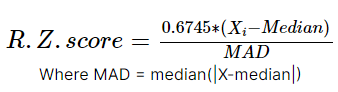

In [22]:
# Define a function to detect and remove outliers using the Median Absolute Deviation (MAD) method
def robust_outliers(col):
    median = np.median(col)  # Calculate the median of the column
    MAD = stats.median_abs_deviation(col)  # Calculate the Median Absolute Deviation (MAD) of the column
    outliers_indices = []  # Initialize a list to store indices of outliers

    # Iterate over values in the column
    for i, value in enumerate(col):
        z = (0.6745 * (value - median) / MAD)  # Calculate the z-score using MAD
        if np.abs(z) > 3:  # Check if the absolute z-score is greater than 3 (indicating an outlier)
            outliers_indices.append(i)  # If yes, add the index of the outlier to the list

    return outliers_indices  # Return the list of indices of outliers

# Create a copy of the DataFrame to preserve the original data
no_out_df = df.copy()

# Iterate over numerical columns and remove outliers using the robust_outliers function
for col in num_cols:
    outliers = robust_outliers(no_out_df[col])  # Detect outliers in the current column
    no_out_df = no_out_df.drop(outliers, axis=0).reset_index(drop=True)  # Remove outliers and reset index


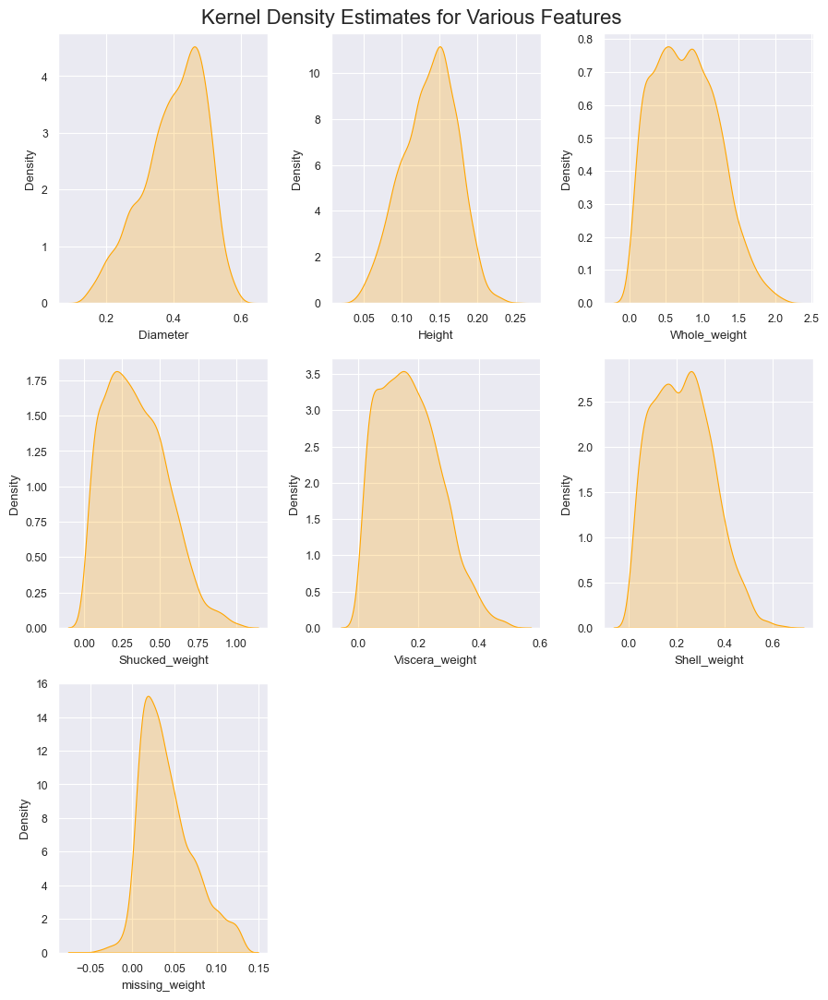

In [23]:
# Create subplots for kernel density estimates of features without outliers
fig, ax = plt.subplots(nrows=3, ncols=3, figsize=(9, 11))
plt.suptitle('Kernel Density Estimates for Various Features', fontsize=16)

# Plot kernel density estimates for each numerical column in the DataFrame without outliers
for i, col in enumerate(num_cols, 0):
    plt.subplot(3, 3, i + 1)
    sns.kdeplot(no_out_df[col], color='orange', fill=True)

# Hide the bottom-right subplot to adjust layout
ax[2, 1].set_visible(False)
ax[2, 2].set_visible(False)

# Adjust the layout of subplots to prevent overlapping
plt.tight_layout()

# Display the plot
plt.show()

In [24]:
# Define the features and target variable after removing outliers
features_out = no_out_df.drop(['Rings', 'Length'], axis=1)  # Features without 'Rings' and 'Length' columns
target_out = no_out_df['Rings']  # Target variable 'Rings'

# Split the data into training and testing sets
x_train_out, x_test_out, y_train_out, y_test_out = train_test_split(features_out, target_out, train_size=0.7, random_state=42)

In [25]:
# Instantiate a pipeline with Ridge regression model for the training data without outliers
rf = GetPipeline(Ridge(), num_cols[1:])  # Assuming GetPipeline is a custom function
rf.fit(x_train_out, y_train_out)  # Fit the model
y_predict = rf.predict(x_test_out)  # Predict the target variable on the test set
print_evaluate(y_test_out, y_predict, x_train_out)  # Print evaluation metrics

Test set evaluation:
_____________________________________
MAE: 1.5786664129691401
MSE: 4.388140041477507
RMSE: 2.094788782067898
R2 Square: 0.5063565377969865
R2 Adjusted: 0.5044845489376653


## Does our model fit a linear model based on the 4 assumptions

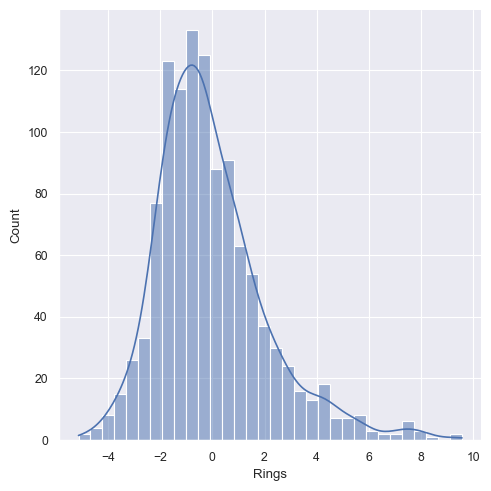

<Axes: ylabel='Rings'>

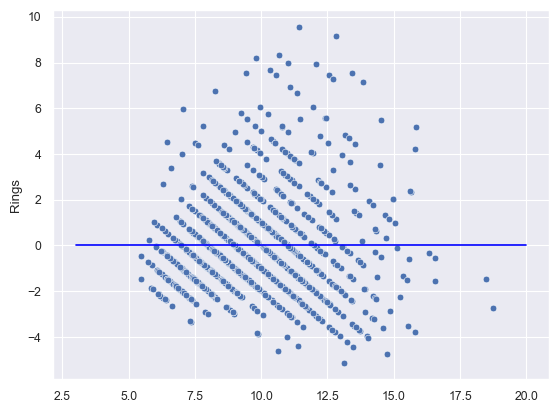

In [26]:
# Calculate the errors between the actual and predicted values
errors = y_test_out - y_predict

# Create a distribution plot of the errors
sns.displot(errors, kde=True)
plt.show()

# Create a scatter plot of predicted values vs. errors
sns.scatterplot(x=y_predict, y=errors)
sns.lineplot(x=[3, 20], y=[0, 0], color='blue')  # Add a horizontal line at y=0

A Linear model makes 4 assumption: and it has failed to have residuals of constant variance throughtout, homoscadeicty , the independeant variables are highly correlated and the features are mostly non-linearly correalted to the dependent variable

## Will a non-linear model produce a better model

In [27]:
# Instantiate a CatBoostRegressor model with evaluation metric set to RMSE
cbr = CatBoostRegressor(eval_metric='RMSE')

# Train the CatBoostRegressor model
cbr.fit(x_train_out, y_train_out)

# Make predictions on the test set using the trained model
preds = cbr.predict(x_test_out)

# Print evaluation metrics
print_evaluate(y_test_out, preds, x_train_out)

Learning rate set to 0.047753
0:	learn: 2.8343684	total: 146ms	remaining: 2m 25s
1:	learn: 2.7882693	total: 150ms	remaining: 1m 14s
2:	learn: 2.7412624	total: 152ms	remaining: 50.4s
3:	learn: 2.7027472	total: 153ms	remaining: 38.1s
4:	learn: 2.6629820	total: 154ms	remaining: 30.7s
5:	learn: 2.6210924	total: 155ms	remaining: 25.8s
6:	learn: 2.5876795	total: 159ms	remaining: 22.5s
7:	learn: 2.5572114	total: 160ms	remaining: 19.9s
8:	learn: 2.5224173	total: 162ms	remaining: 17.8s
9:	learn: 2.4920132	total: 163ms	remaining: 16.1s
10:	learn: 2.4658413	total: 165ms	remaining: 14.8s
11:	learn: 2.4401589	total: 166ms	remaining: 13.7s
12:	learn: 2.4135523	total: 167ms	remaining: 12.7s
13:	learn: 2.3883033	total: 168ms	remaining: 11.9s
14:	learn: 2.3649544	total: 169ms	remaining: 11.1s
15:	learn: 2.3428351	total: 171ms	remaining: 10.5s
16:	learn: 2.3253260	total: 172ms	remaining: 9.95s
17:	learn: 2.3049622	total: 173ms	remaining: 9.46s
18:	learn: 2.2860235	total: 175ms	remaining: 9.02s
19:	learn

In [37]:
# Define the grid of hyperparameters to search over
grid = {'learning_rate': [0.01, 0.05, 0.08, 0.1, 0.15, 0.2], 
        'iterations': [2, 10, 50, 100, 200, 400, 500, 700] ,
        'bootstrap_type':['MVS' , 'Bayesian' , 'Bernoulli'] ,
        'l2_leaf_reg':[0.1, 0.2 , 0.5 , 0.7 , 0.9 , 3]}

In [38]:
#Instantiate a CatBoostRegressor model with evaluation metric set to RMSE
cbr = CatBoostRegressor(eval_metric='RMSE')

# Perform grid search using the grid of hyperparameters specified and training data
# grid_search_result will contain the results of the grid search
grid_search_result = cbr.grid_search(grid,
                                     X=x_train_out,
                                     y=y_train_out,
                                     plot=True)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 10.0420372	test: 9.8550495	best: 9.8550495 (0)	total: 1.77ms	remaining: 1.77ms
1:	learn: 9.9474024	test: 9.7614678	best: 9.7614678 (1)	total: 3.2ms	remaining: 0us

bestTest = 9.761467762
bestIteration = 1

0:	loss: 9.7614678	best: 9.7614678 (0)	total: 44.7ms	remaining: 38.6s
0:	learn: 10.0420372	test: 9.8550495	best: 9.8550495 (0)	total: 1.17ms	remaining: 1.17ms
1:	learn: 9.9474024	test: 9.7614678	best: 9.7614678 (1)	total: 2.25ms	remaining: 0us

bestTest = 9.761467762
bestIteration = 1

1:	loss: 9.7614678	best: 9.7614678 (0)	total: 49.8ms	remaining: 21.5s
0:	learn: 10.0420644	test: 9.8552861	best: 9.8552861 (0)	total: 1.4ms	remaining: 1.4ms
1:	learn: 9.9476219	test: 9.7606930	best: 9.7606930 (1)	total: 2.44ms	remaining: 0us

bestTest = 9.760693002
bestIteration = 1

2:	loss: 9.7606930	best: 9.7606930 (2)	total: 53.9ms	remaining: 15.5s
0:	learn: 9.6599622	test: 9.4740103	best: 9.4740103 (0)	total: 1.39ms	remaining: 1.39ms
1:	learn: 9.2073517	test: 9.0264432	best: 9.0264432 (1